# Paramètres à adapter

In [1]:
# Le chemin du dossier dans lequel se trouvent les fichiers X_train.csv et Y_train.csv
# >>> Penser à laisser un \ ou un / (selon son système d'exploitation) à la suite du nom du dossier
data_folder_path = "/Users/antoine/Documents/DataScientest/Projet/data/"

# Le chemin du dossier dans lequel se trouvent les images originales 
# >>> Penser à laisser un \ ou un / (selon son système d'exploitation) à la suite du nom du dossier
img_folder_path = "/Users/antoine/Pictures/DataScientest_Rakuten/original/image_train/"

# Imports

In [2]:
import pandas as pd
import numpy as np

from scipy.stats import chi2_contingency

import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

import imageio
import cv2

import math
import random

import os

In [3]:
X = pd.read_csv(data_folder_path + 'X_train.csv', index_col=0)
y = pd.read_csv(data_folder_path + 'Y_train.csv', index_col=0)

# Aperçu général

In [4]:
display(X.head())
X.info()

,designation,description,productid,imageid
0,Olivia: Personalisiertes Notizbuch / 150 Seite...,NaN,3804725264,1263597046
1,Journal Des Arts (Le) N° 133 Du 28/09/2001 - L...,NaN,436067568,1008141237
2,Grand Stylet Ergonomique Bleu Gamepad Nintendo...,PILOT STYLE Touch Pen de marque Speedlink est ...,201115110,938777978
3,Peluche Donald - Europe - Disneyland 2000 (Mar...,NaN,50418756,457047496
4,La Guerre Des Tuques,Luc a des id&eacute;es de grandeur. Il veut or...,278535884,1077757786


<class 'pandas.core.frame.DataFrame'>
Index: 84916 entries, 0 to 84915
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   designation  84916 non-null  object
 1   description  55116 non-null  object
 2   productid    84916 non-null  int64 
 3   imageid      84916 non-null  int64 
dtypes: int64(2), object(2)
memory usage: 3.2+ MB


In [5]:
display(y.head())
y.info()

,prdtypecode
0,10
1,2280
2,50
3,1280
4,2705


<class 'pandas.core.frame.DataFrame'>
Index: 84916 entries, 0 to 84915
Data columns (total 1 columns):
 #   Column       Non-Null Count  Dtype
---  ------       --------------  -----
 0   prdtypecode  84916 non-null  int64
dtypes: int64(1)
memory usage: 1.3 MB


# Doublons

In [6]:
def duplicates(df, columns='all', row_filter=None, rows=0, display_all_columns=False, specify_df=False):

    """
    Cette fonction permet de vérifier l'unicité des valeurs d'une colonne ou celle des combinaisons de valeurs entre 
    plusieurs colonnes. Elle donne le nombre de doublons (en comptant les premières occurrences), et indique le 
    nombre de ces doublons qui sont des premières occurrences.

    Cette fonction requiert l'importation suivante pour afficher les lignes où se trouvent des doublons: from IPython.display import display

    PARAMETERS
    -------------------------------
                'columns' : Par défaut, a pour valeur 'all', ce qui indique à la fonction de calculer le nombre de lignes qui 
                            sont des doublons sur l'ensemble des colonnes. On peut aussi entrer dans l'argument 'columns', soit un 
                            soit plusieurs en-têtes de colonnes, lesquels doivent être des chaînes de caractères. Si l'on entre plusieurs 
                            en-têtes, ceux-ci doivent être compris dans une liste. Dans ce dernier cas, la fonction vérifie si des lignes 
                            sont des doublons sur l'ensemble des colonnes indiquées.
             'row_filter' : Tuple contenant une condition pour filtrer les lignes du dataframe sur lequel compter les doublons.
                            Si l'on veut que le filtre s'applique aussi aux lignes dont on calcule quel pourcentage sont concernées 
                            par les doublons, alors il ne faut pas utiliser ce paramètre mais rentrer directement dans le paramètre 'df'
                            le dataframe filtré.
                   'rows' : Il s'agit d'indiquer le nombre de lignes avec doublons que l'on veut afficher (à supposer qu'il y en ait). 
                            S'il n'y a pas autant de doublons que le nombre indiqué, toutes les lignes avec doublons sont affichées.
    'display_all_columns' : Permet d'indiquer, en entrant la valeur True, que toutes les colonnes du dataframe doivent être affichées. 
                            Si l'on ne le fait pas, il faut laisser la valeur par défaut (False), et le nombre de colonnes affichées 
                            dépendra du nombre de colonnes du dataframe et des réglages d'affichage en vigueur.
    """
    
    all_cols = columns=='all'
    single_col = (type(columns)==str) | ((type(columns)==list) & (len(columns)==1))
    multiple_cols = (type(columns)==list) & (len(columns)>1)
    subset = columns if columns!='all' else None

    if type(row_filter) == type(None):
        all_duplicates = sum(df.duplicated(subset=subset, keep=False))
    else:
        all_duplicates = sum(df[row_filter].duplicated(subset=subset, keep=False))
    if all_duplicates == 0:
        if all_cols:
            print(f"Le dataframe {df_name + ' ' if specify_df==True else ''}ne contient aucun doublon.")
        elif single_col:
            print(f"La colonne {columns} {'du dataframe ' + df_name + ' ' if specify_df==True else ''}ne contient aucun doublon.")
        elif multiple_cols:
            print(f"Aucun doublon sur le sous-ensemble de colonnes {columns} {'du dataframe ' + df_name + ' ' if specify_df==True else ''}.")
    else:
        pct_duplicates = round(all_duplicates / len(df) *100, 1)
        if type(row_filter)==type(None):
            second_occ = sum(df.duplicated(subset=subset)) 
        else:
            second_occ = sum(df[row_filter].duplicated(subset=subset))
        first_occ = all_duplicates - second_occ
        pct_first = round(first_occ / all_duplicates *100, 1)
        pct_duplicates_so = round(second_occ / len(df) *100, 1)
        print(f"{all_duplicates} {'lignes ' if not single_col else ''}doublons \
{'dans la colonne' if single_col else ('sur le sous-ensemble de colonnes' if multiple_cols else '')}\
{' ' + str(columns) if not all_cols else ''}{'dans le dataframe ' + df_name + ' ' if specify_df==True else ''} \
(= {pct_duplicates}% des {'lignes' if not single_col else 'valeurs'}):\n    \
• {first_occ} premières occurrences ({pct_first}% des doublons)\n    \
• {second_occ} secondes occurrences ({100 - pct_first}% des doublons, {pct_duplicates_so}% des {'lignes' if not single_col else 'valeurs'})")
        if (rows>0) & (rows<all_duplicates):
            print(f"\nÉchantillon de {rows} {'de ces lignes' if not single_col else 'des lignes où se trouvent ces'} doublons :")
        elif rows>=all_duplicates:    
            print("\nVoici ces lignes doublons :" if all_columns else "\nCes doublons se trouvent aux lignes suivantes :")
        with pd.option_context('display.max_rows', rows, 'display.min_rows', rows,
                               'display.max_columns', None if display_all_columns==True else pd.get_option("display.max_columns")):
            display(df[df.duplicated(subset=subset, keep=False)].sort_values(subset if subset!=None else list(df.columns)))

In [7]:
duplicates(X, columns='productid')
duplicates(X, columns='imageid')

La colonne productid ne contient aucun doublon.
La colonne imageid ne contient aucun doublon.


In [8]:
duplicates(X, columns='designation', rows=20, display_all_columns=True)

4073 doublons dans la colonne designation (= 4.8% des valeurs):
    • 1422 premières occurrences (34.9% des doublons)
    • 2651 secondes occurrences (65.1% des doublons, 3.1% des valeurs)

Échantillon de 20 des lignes où se trouvent ces doublons :


,designation,description,productid,imageid
884,01:16 2rm Haute Vitesse Rc Voiture De Course À...,01:16 2RM haute vitesse RC voiture de course d...,4006488750,1275488940
10341,01:16 2rm Haute Vitesse Rc Voiture De Course À...,01:16 2RM haute vitesse RC voiture de course d...,4006488647,1275488903
69681,01:20 2.4ghz 2rm Radio Remote Control Off Road...,01:20 2.4GHZ 2RM Radio Remote Control Off Road...,3976901220,1271293302
43764,01:20 2.4ghz 2rm Radio Remote Control Off Road...,01:20 2.4GHZ 2RM Radio Remote Control Off Road...,4006488521,1275485726
11315,1 Paire Joy-Con Gamepad Poignée De Verrouillag...,1 paire Joy-Con Gamepad poignée de verrouillag...,3814580649,1248217842
50185,1 Paire Joy-Con Gamepad Poignée De Verrouillag...,1 paire Joy-Con Gamepad poignée de verrouillag...,3814580751,1248217908
3529,1 Pcs Vines Feuilles Fenêtre Porte Tulle Ridea...,1 PCS Vines Feuilles Tulle porte fenêtre ridea...,4010262293,1275984161
49767,1 Pcs Vines Feuilles Fenêtre Porte Tulle Ridea...,1 PCS Vines Feuilles Tulle porte fenêtre ridea...,4022993783,1277606108
46119,1 paire chaussettes de coton Knee High Stripe ...,1 paire chaussettes de coton Knee High Stripe ...,3898718626,1261388125
28493,1 paire chaussettes de coton Knee High Stripe ...,1 paire chaussettes de coton Knee High Stripe ...,3898718632,1261388180


Calculons les doublons dans la colonne des descriptions, mais sans prendre en compte les lignes où elles sont manquantes.

In [9]:
duplicates(X, columns='description', row_filter=(~X['description'].isna()), rows=20, display_all_columns=True)

10611 doublons dans la colonne description (= 12.5% des valeurs):
    • 3001 premières occurrences (28.3% des doublons)
    • 7610 secondes occurrences (71.7% des doublons, 9.0% des valeurs)

Échantillon de 20 des lignes où se trouvent ces doublons :


,designation,description,productid,imageid
23393,Lindner 2251325 Capsules Pour Monnaies-Paquet ...,Les capsules LINDNER sont de plus en plus uti...,3817904605,1248853290
70482,Lindner 2251022 Capsules Pour Monnaies-Paquet ...,Les capsules LINDNER sont de plus en plus uti...,3817904565,1248853110
31153,Lindner 8332030 Etuis Numismatiques Carton Har...,Les étuis numismatiques en carton de HARTBERG...,3817906610,1248862892
52979,Lindner 8330175 Etuis Numismatiques Carton Har...,Les étuis numismatiques en carton de HARTBERG...,3817906586,1248862792
33865,Lindner 8320043 Etuis Numismatiques Carton Har...,Les étuis numismatiques en carton de HARTBERG...,3817906536,1248862667
43442,Creative Mobile Mur Avec Apposé Décoratif Mur ...,&amp; Nbsp; Creative mobile mur avec Apposé mu...,4006906666,1275663720
67545,Creative Mobile Mur Avec Apposé Décoratif Mur ...,&amp; Nbsp; Creative mobile mur avec Apposé mu...,4006906642,1275663435
8060,Salle De Bain En Plastique Coin Cuisine Suppor...,&amp; nbsp plastique; Salle de bain Coin cuisi...,3813440962,1247901594
55582,Salle De Bain En Plastique Coin Cuisine Suppor...,&amp; nbsp plastique; Salle de bain Coin cuisi...,4017265460,1276829414
34074,8 Cell Frozen Ice Cream Pop Mold Popsicle Make...,&gt;,4061577028,1283403770


In [10]:
duplicates(X, columns=['designation', 'description'], rows=20, display_all_columns=True)

2366 lignes doublons sur le sous-ensemble de colonnes ['designation', 'description'] (= 2.8% des lignes):
    • 952 premières occurrences (40.2% des doublons)
    • 1414 secondes occurrences (59.8% des doublons, 1.7% des lignes)

Échantillon de 20 de ces lignes doublons :


,designation,description,productid,imageid
11315,1 Paire Joy-Con Gamepad Poignée De Verrouillag...,1 paire Joy-Con Gamepad poignée de verrouillag...,3814580649,1248217842
50185,1 Paire Joy-Con Gamepad Poignée De Verrouillag...,1 paire Joy-Con Gamepad poignée de verrouillag...,3814580751,1248217908
21577,1 paire de coton Cartoon Fluffy courts Yeux Ch...,1 paire de coton Cartoon Fluffy courts Yeux Ch...,3898723811,1261415005
43929,1 paire de coton Cartoon Fluffy courts Yeux Ch...,1 paire de coton Cartoon Fluffy courts Yeux Ch...,3898723829,1261415030
22538,1 paire de coton Cartoon longs yeux Chaussette...,1 paires coton Cartoon longs yeux Chaussettes ...,3898723733,1261414607
32864,1 paire de coton Cartoon longs yeux Chaussette...,1 paires coton Cartoon longs yeux Chaussettes ...,3898723734,1261414614
22874,1 paires coton doux Chaussettes solides pour B...,1 paires coton doux Chaussettes solides pour l...,3898720354,1261400063
31220,1 paires coton doux Chaussettes solides pour B...,1 paires coton doux Chaussettes solides pour l...,3898720146,1261399976
16866,100% Nouveau 2019 Marine Life 50x50cm Linge De...,100% NOUVEAU 2019 Marine Life 50x50cm Linge de...,4076593495,1287365618
79673,100% Nouveau 2019 Marine Life 50x50cm Linge De...,100% NOUVEAU 2019 Marine Life 50x50cm Linge de...,4076974719,1286953423


Comptons de nouveau les doublons sur le sous-ensemble de colonnes ['designation', 'description'] mais cette fois sans compter comme doublons les lignes où la description est manquante.

In [11]:
duplicates(X, columns=['designation', 'description'], row_filter=(~X['description'].isna()), rows=20, display_all_columns=True)

2169 lignes doublons sur le sous-ensemble de colonnes ['designation', 'description'] (= 2.6% des lignes):
    • 875 premières occurrences (40.3% des doublons)
    • 1294 secondes occurrences (59.7% des doublons, 1.5% des lignes)

Échantillon de 20 de ces lignes doublons :


,designation,description,productid,imageid
11315,1 Paire Joy-Con Gamepad Poignée De Verrouillag...,1 paire Joy-Con Gamepad poignée de verrouillag...,3814580649,1248217842
50185,1 Paire Joy-Con Gamepad Poignée De Verrouillag...,1 paire Joy-Con Gamepad poignée de verrouillag...,3814580751,1248217908
21577,1 paire de coton Cartoon Fluffy courts Yeux Ch...,1 paire de coton Cartoon Fluffy courts Yeux Ch...,3898723811,1261415005
43929,1 paire de coton Cartoon Fluffy courts Yeux Ch...,1 paire de coton Cartoon Fluffy courts Yeux Ch...,3898723829,1261415030
22538,1 paire de coton Cartoon longs yeux Chaussette...,1 paires coton Cartoon longs yeux Chaussettes ...,3898723733,1261414607
32864,1 paire de coton Cartoon longs yeux Chaussette...,1 paires coton Cartoon longs yeux Chaussettes ...,3898723734,1261414614
22874,1 paires coton doux Chaussettes solides pour B...,1 paires coton doux Chaussettes solides pour l...,3898720354,1261400063
31220,1 paires coton doux Chaussettes solides pour B...,1 paires coton doux Chaussettes solides pour l...,3898720146,1261399976
16866,100% Nouveau 2019 Marine Life 50x50cm Linge De...,100% NOUVEAU 2019 Marine Life 50x50cm Linge de...,4076593495,1287365618
79673,100% Nouveau 2019 Marine Life 50x50cm Linge De...,100% NOUVEAU 2019 Marine Life 50x50cm Linge de...,4076974719,1286953423


# Répartition des produits entre les catégories

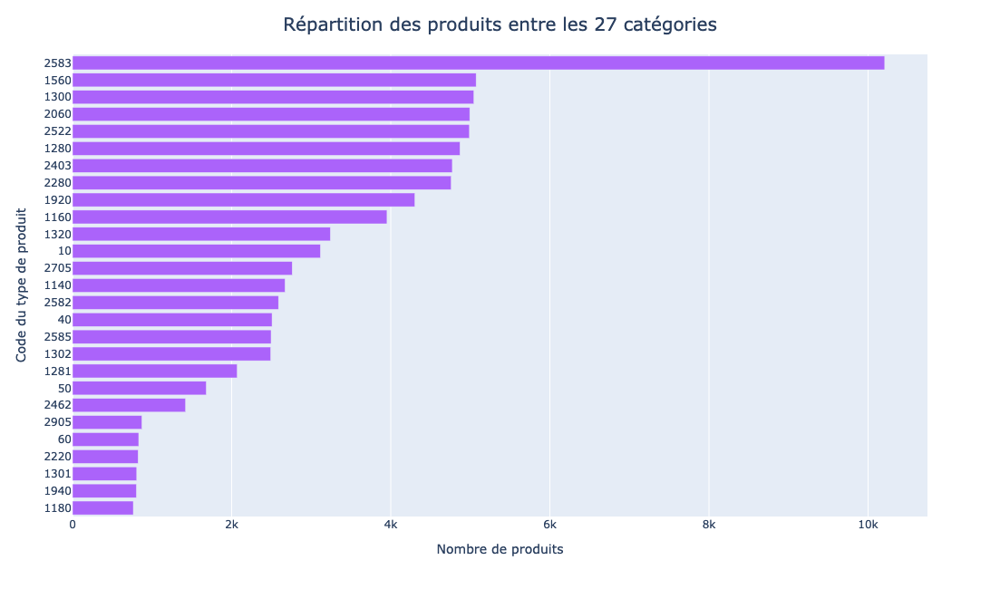

In [12]:
cat_dist = y.value_counts().to_frame().reset_index()
cat_dist = cat_dist.rename(columns = {'count': 'nombre_produits'})

color_discrete_sequence = [px.colors.qualitative.Plotly[3]]*len(cat_dist)

fig = px.bar(data_frame = cat_dist, 
             x = "nombre_produits",
             y = "prdtypecode",
             color_discrete_sequence = color_discrete_sequence, 
             orientation='h',
             height = 650)

fig.update_layout(
    title={'text': f"Répartition des produits entre les {y['prdtypecode'].nunique()} catégories",
           'y': 0.97,
           'x': 0.5,
           'font': {'size': 20},
           'xanchor': 'center',
           'yanchor': 'top'}, 
    yaxis={'type': 'category',
           'title': 'Code du type de produit', 
           'categoryorder': 'total ascending'}, 
    xaxis={'title': 'Nombre de produits'}
)

fig.show()

In [13]:
print("écart-type :", round(np.std(y.value_counts().to_frame().reset_index()['count'])))

écart-type : 2064


# Descriptions manquantes

Comme vu plus haut dans la partie <i>Aperçu général</i>, il n’y a de valeurs manquantes que parmi les descriptions des produits. 

## Taux de descriptions non-manquantes

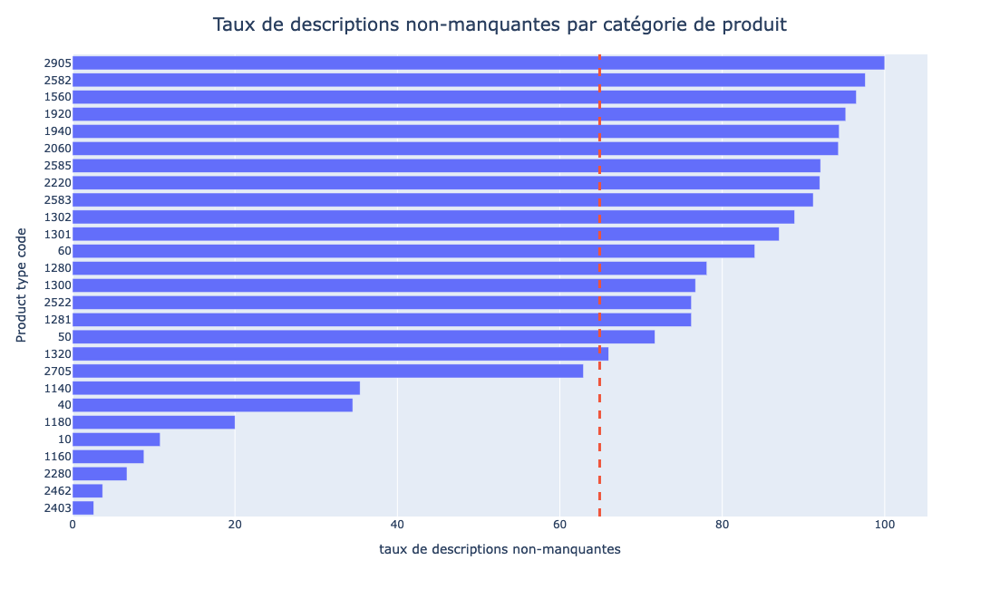

Pourcentage attendu de descriptions non-manquantes : 64.9%


In [14]:
miss_desc = y.copy()
miss_desc['description_manquante'] = X['description'].isna().map({True: 'oui', False: 'non'})

pct_non_missing_global = len(miss_desc.loc[miss_desc['description_manquante']=='non']) / len(miss_desc) *100

miss_desc['nombre_produits'] = miss_desc['prdtypecode']
miss_desc = miss_desc.groupby(['prdtypecode', 'description_manquante']).count().reset_index()
miss_desc = pd.merge(left = miss_desc,
                     right = cat_dist.rename(columns={'nombre_produits': 'produits_dans_la_categorie'}), 
                     left_on = 'prdtypecode', 
                     right_on = 'prdtypecode')
miss_desc['pct_de_la_categorie'] = round(miss_desc['nombre_produits'] / miss_desc['produits_dans_la_categorie'] *100, 1).astype(str) + '%'

pct_non_missing = miss_desc.loc[miss_desc['description_manquante']=='non'].reset_index(drop=True)
pct_non_missing = pct_non_missing.rename(columns={'pct_de_la_categorie':'pct_non_manquantes', 'nombre_produits':'non_manquantes'})
pct_non_missing = pct_non_missing.drop('description_manquante', axis=1)
pct_non_missing['pct_non_manquantes'] = pct_non_missing['pct_non_manquantes'].str[:-1].astype('float')


fig = px.bar(data_frame = pct_non_missing, 
             x = "pct_non_manquantes",
             y = "prdtypecode",
             hover_data = {'non_manquantes': True, 'produits_dans_la_categorie': True},
             orientation='h',
             height = 650)
fig.update_layout(
    title={'text': f"Taux de descriptions non-manquantes par catégorie de produit",
           'y': 0.97,
           'x': 0.5,
           'font': {'size': 20},
           'xanchor': 'center',
           'yanchor': 'top'},
    yaxis={'type': 'category',
           'title': 'Product type code', 
           'categoryorder': 'total ascending'}, 
    xaxis={'title': 'taux de descriptions non-manquantes'}
)
fig.add_vline(x=pct_non_missing_global, line_width=3, line_dash="dash", line_color=px.colors.qualitative.Plotly[1])
fig.show()

print(f"Pourcentage attendu de descriptions non-manquantes : {round(pct_non_missing_global, 1)}%")

On s'attendrait, s’il n’y avait pas de corrélation entre présence ou non de description et catégorie du produit, à ce que toutes les catégories aient le même pourcentage de descriptions (non-)manquantes, lequel serait le pourcentage général de descriptions (non-)manquantes. On voit sur ce graphique que c'est loin d'être le cas : les taux de descriptions non-manquantes diffèrent beaucoup entre eux et diffèrent beaucoup du taux attendu de 65%, indiqué par la ligne en pointillés rouges.

Mais l'inégalité des pourcentages de descriptions manquantes ne suffit pas pour déterminer s'il y a une dépendance statistiquement significative entre présence ou non de description et catégorie du produit, car il faut pondérer ces pourcentages par l'importance de chaque catégorie en nombre de produits. C'est l'objet du graphique suivant.

La dépendance entre présence ou non de description et catégorie de produit pourrait ne pas être statistiquement significative si le poids des différentes catégories (c'est-à-dire le nombre de produits qu'elles regroupent chacune) contrebalançait l'inégalité de leurs taux de descriptions (non-)manquantes. Si les catégories avec le taux le plus proche du taux attendu étaient beaucoup plus importantes, et que les catégories avec un taux éloigné du taux attendu l'étaient très peu, alors le lien pourrait ne pas être statistiquement significatif. Mais ce n'est pas du tout ce que l'on observe sur le graphique ci-dessous. 

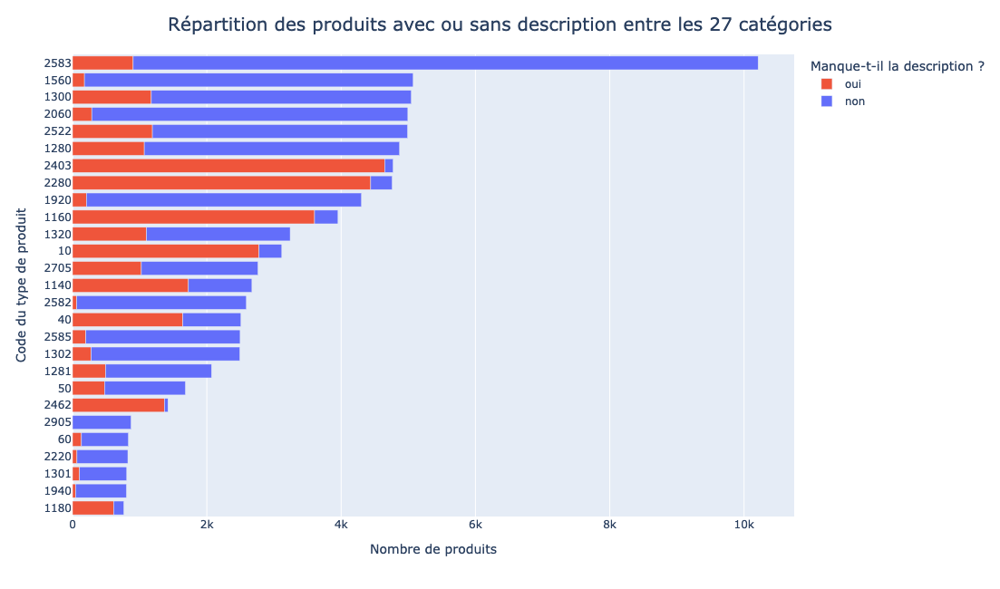

In [15]:
fig = px.bar(data_frame = miss_desc, 
             x = "nombre_produits",
             y = "prdtypecode", 
             color = 'description_manquante', 
             hover_data = {'pct_de_la_categorie': True}, 
             category_orders = {'description_manquante': ['oui', 'non']},
             color_discrete_map = {'oui': px.colors.qualitative.Plotly[1], 
                                   'non': px.colors.qualitative.Plotly[0]}, 
             orientation='h',
             height = 650)

fig.update_layout(
    title={'text': f"Répartition des produits avec ou sans description entre les {y['prdtypecode'].nunique()} catégories",
           'y': 0.97,
           'x': 0.5,
           'font': {'size': 20},
           'xanchor': 'center',
           'yanchor': 'top'}, 
    legend={'title': 'Manque-t-il la description ?'},
    yaxis={'type': 'category',
           'title': 'Code du type de produit', 
           'categoryorder': 'total ascending'}, 
    xaxis={'title': 'Nombre de produits'}
)

fig.show()

## Corrélation avec le type de produit : test du Khi<sup>2</sup> d'indépendance

Nous allons faire un test du khi2 pour nous éclairer quant à la question de savoir s'il y a une corrélation entre l'absence de description de produit et la catégorie du produit. Notons H0 notre hypothèse nulle, et H1 l'hypothèse alternative.

- H0 = Il n'y a pas de corrélation entre présence ou non de description et type du produit.
- H1 = Il y a corrélation entre présence ou non de description et type du produit.

Ce test retournera une p-value, qui est la probabilité sous l'hypothèse nulle d'obtenir des données égales ou plus extrêmes que les données observées (utilisées dans le test). Cette valeur n'est donc pas la probabilité de l'hypothèse nulle sachant les données (ce qui nous intéresserait le plus de savoir) et ne permet pas de la connaître (à moins d'être égale à 0), mais elle nous renseigne néanmoins à son propos : plus la p-value est faible, plus la probabilité de l'hypothèse nulle sachant les données est faible.

On place le seuil du test à 0,05 : si la p-value obtenue à l'issue du test est inférieure à ce seuil, il y aura une forte présomption contre H0.

### Conditions de validité

Il nous faut d'abord vérifier que les conditions de validité du test sont remplies, à savoir que (critère de Cochran):
- les valeurs attendues dans l'hypothèse H0 sont toutes supérieures ou égales à 1
- il n'y a pas plus de 20% de ces valeurs qui sont inférieures à 5

In [16]:
# Table de contingence
contingency_table = pd.crosstab(y['prdtypecode'],
                                X['description'].isna().map({True: 'yes', False: 'no'}).rename('is_desc_missing'), 
                                margins=True)

# À partir de la table de contingence, on calcule les valeurs attendues dans l'hypothèse H0 :
tx = contingency_table.loc[["All"], :]
ty = contingency_table.loc[:, ["All"]]
n = contingency_table.loc["All", "All"]
expected = ty.dot(tx) / n
expected.drop('All', inplace=True, axis=0)
expected.drop('All', inplace=True, axis=1)

print("nombre de valeurs attendues dans l'hypothèse H0 inférieures à 1 : " + str(int(expected[expected < 1].sum().sum())))
print("pourcentage de valeurs attendues dans l'hypothèse H0 inférieures à 5 : " 
      + str(expected[expected < 5].sum().sum() / (expected.shape[0] * expected.shape[1]) *100) + "%")

nombre de valeurs attendues dans l'hypothèse H0 inférieures à 1 : 0
pourcentage de valeurs attendues dans l'hypothèse H0 inférieures à 5 : 0.0%


Les conditions de validité du test sont respectées.

### Contributions à la statistique Khi<sup>2</sup>

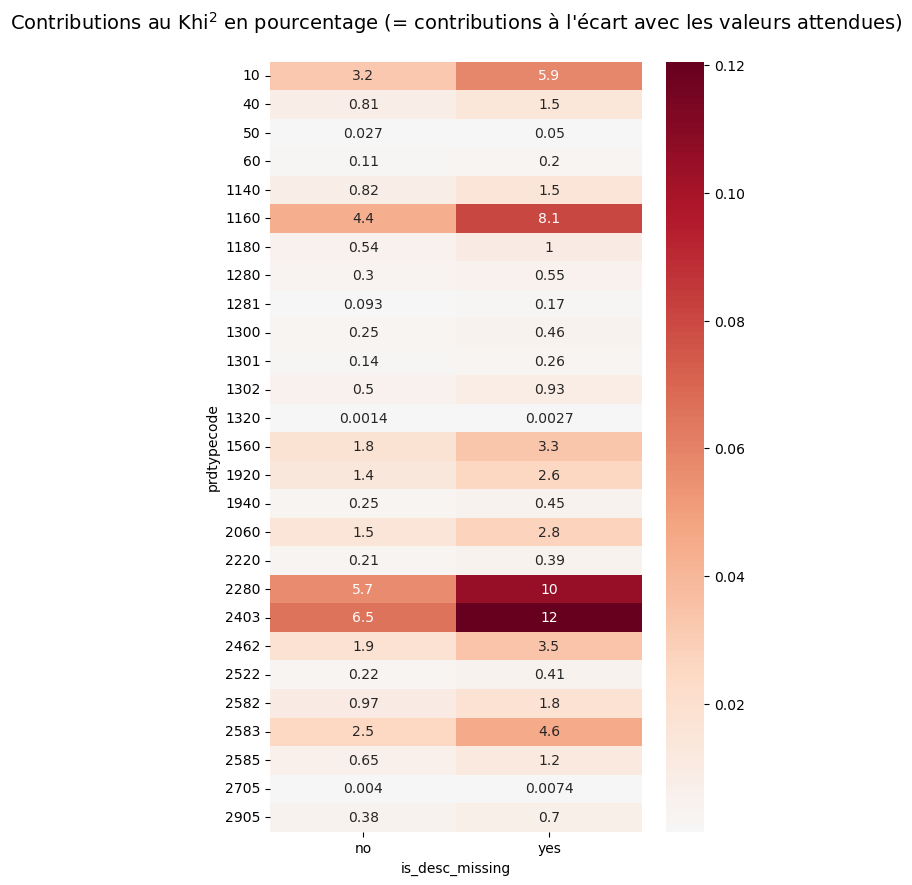

,prdtypecode,%_of_all_non_missing_desc,%_of_all_missing_desc,expected
0,10,0.61,9.32,3.67
1,40,1.57,5.51,2.95
2,50,2.19,1.60,1.98
3,60,1.27,0.45,0.98
4,1140,1.71,5.79,3.15
5,1160,0.63,12.09,4.66
6,1180,0.28,2.05,0.90
7,1280,6.90,3.58,5.74
8,1281,2.86,1.65,2.44
9,1300,7.03,3.94,5.94


In [17]:
# On calcule pour chaque valeur du tableau de contingence le pourcentage qu'elle représente des produits aux descriptions manquantes
# / non-manquantes, et on calcule le pourcentage attendu dans l'hypothèse H0 (qui est le même pour les valeurs manquantes et non-manquantes)
observed_vs_expected = contingency_table.copy()
observed_vs_expected['no'] = observed_vs_expected['no'] / observed_vs_expected.loc['All', 'no'] *100
observed_vs_expected['yes'] = observed_vs_expected['yes'] / observed_vs_expected.loc['All', 'yes'] *100
observed_vs_expected['All'] = observed_vs_expected['All'] / observed_vs_expected.loc['All', 'All'] *100
observed_vs_expected.rename(columns={'no':'%_of_all_non_missing_desc', 
                                     'yes':'%_of_all_missing_desc', 
                                     'All':'expected'}, inplace=True)
observed_vs_expected = round(observed_vs_expected, 2)
observed_vs_expected.reset_index(inplace=True)
observed_vs_expected = observed_vs_expected.rename_axis(None, axis=1)

# On crée une heatmap des contributions au chi2 :
ct = contingency_table.drop('All', axis=0).drop('All', axis=1)
measures = (ct-expected)**2/expected
chi2 = measures.sum().sum()
contributions = measures/chi2
plt.figure(figsize=(6, 10))
sns.heatmap(data=contributions, cmap='RdBu_r', center=0, annot=contributions *100)
plt.title("Contributions au Khi$^2$ en pourcentage (= contributions à l'écart avec les valeurs attendues)\n", fontsize=14)
# sns.heatmap(data=contributions, cmap='RdBu_r', center=0, annot=contributions *100, cbar=False)
# plt.title("Contributions au Khi$^2$ en pourcentage\n", fontsize=16)
plt.show()

observed_vs_expected

Dans le tableau ci-dessus, la colonne 'expected' indique 

### Résultat

In [18]:
# test du chi2 – calcul de la p-value :
print(f"\np-value : {chi2_contingency(contingency_table)[1]}")


p-value : 0.0


On peut rejeter avec confiance l'hypothèse nulle.

# Dimensions des images et descriptions

## Descriptions

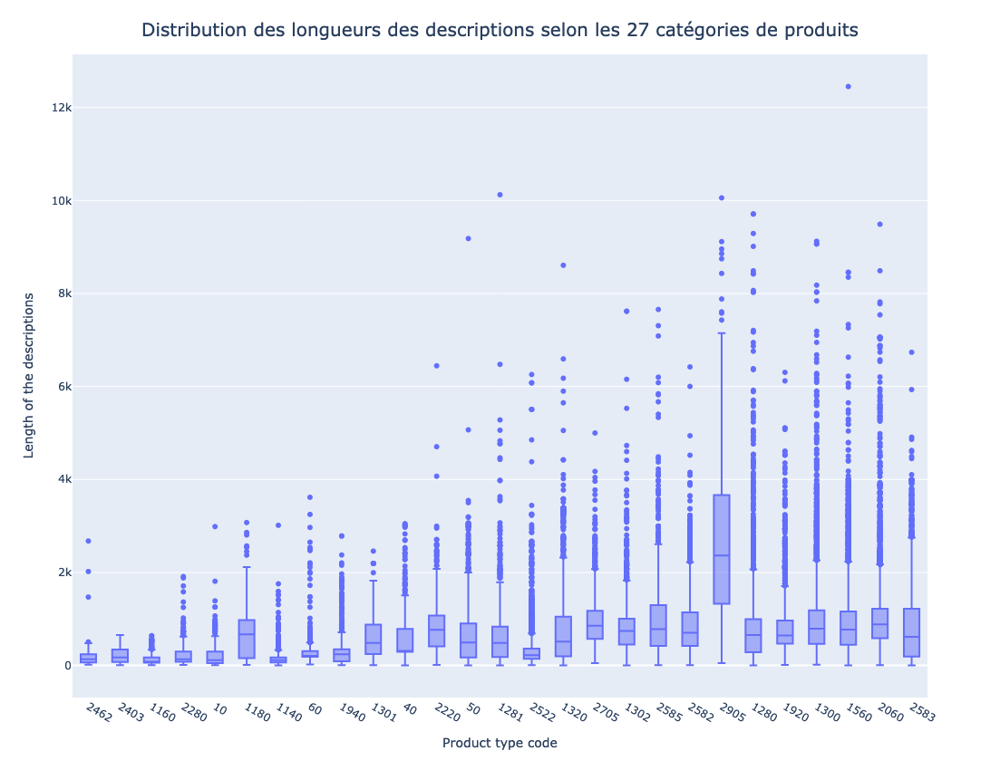

In [19]:
len_desc = pd.DataFrame(X["description"].str.len().rename('len_desc'))
len_desc = len_desc.merge(y, left_index=True, right_index=True)
len_desc['prdtypecode'] = len_desc['prdtypecode'].astype('category')

fig = px.box(data_frame = len_desc, 
             x = "prdtypecode", 
             y = "len_desc",
             height = 850)
fig.update_layout(
    title={'text': f"Distribution des longueurs des descriptions selon les {y['prdtypecode'].nunique()} catégories de produits",
           'y': 0.97,
           'x': 0.5,
           'font': {'size': 20},
           'xanchor': 'center',
           'yanchor': 'top'},
    yaxis={'title': 'Length of the descriptions'}, 
    xaxis={'type': 'category',
           'title': 'Product type code', 
           'categoryorder': 'total ascending'}
)
fig.show()

## Images

In [20]:
img_widths = []
img_heights = []
img_colored_or_gray = []

img_files = ["image_"] *len(X) + X['imageid'].astype('str') + ["_product_"] *len(X) + X['productid'].astype('str') + [".jpg"] *len(X)

for i, file in enumerate(img_files):
    try:
        width, height, color = imageio.v2.imread(img_folder_path + str(y.loc[i, 'prdtypecode']) + "/" + file).shape
    except:
        width, height, color = imageio.v2.imread(img_folder_path + file).shape
    img_widths.append(width)
    img_heights.append(height)
    img_colored_or_gray.append('colored') if color==3 else img_colored_or_gray.append('gray')

print("valeurs uniques des largeurs d'images (en nombre de pixels) : " + str(pd.Series(img_widths).unique()))
print("valeurs uniques des hauteurs d'images (en nombre de pixels) : " + str(pd.Series(img_heights).unique()))
pct_colored = pd.Series(img_colored_or_gray).value_counts(normalize=True)['colored'] *100
print("pourcentage d'images en couleurs : " + str(round(pct_colored) if pct_colored==100 else pct_colored) + "%")

valeurs uniques des largeurs d'images (en nombre de pixels) : [500]
valeurs uniques des hauteurs d'images (en nombre de pixels) : [500]
pourcentage d'images en couleurs : 100%


Les images sont toutes de dimensions 500 x 500 et sont en couleurs.

# Compréhension des catégories : échantillons d'images

Les catégories des produits sont désignées par des nombres, et l'on ne sait donc pas directement à quoi elles correspondent.

Pour comprendre quels types de produits inclue chaque catégorie, on génère ci-dessous, pour chacune, un échantillon aléatoire des images de ses produits.

Les cellules contenant l'appel à la fonction img_sample peuvent être relancées autant de fois qu'on le souhaite, pour obtenir un échantillon à chaque fois différent.

In [21]:
def img_sample(prdtypecode, random_state=None, print_file_names=False):
    """ 
    Cette fonction renvoie un échantillon de 8 images tirées aléatoirement parmi celles d'une catégorie de produits donnée.
    Paramètre prdtypecode : le code de la catégorie de produits. Doit être l'une des valeurs de y['prdtypecode'], dans le même format.
    """
    
    folder_path = img_folder_path # cf. tout en haut de ce noteook, partie "Paramètres à adapter" pour définir img_folder_path
    if os.path.exists(img_folder_path + str(prdtypecode)):         # La condition if ci-contre sert à s'adapter au cas où les images
        folder_path = img_folder_path + str(prdtypecode) + "/"     # auraient été rangées dans des sous-dossiers selon leurs catégories
    random.seed(random_state)
    random_indexes = random.sample(list(y['prdtypecode'].loc[y['prdtypecode']==prdtypecode].index), 8)
    
    fig = plt.figure(figsize = (15, 13))
    for i in range(len(random_indexes)):
        file_path = folder_path + "image_" + X.loc[random_indexes[i], 'imageid'].astype('str') + "_product_" + X.loc[random_indexes[i], 'productid'].astype('str') + ".jpg"
        img = cv2.imread(file_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        fig.add_subplot(math.ceil((i+1)/4),4,i+1)
        plt.imshow(img)
        plt.xticks([])
        plt.yticks([])
    plt.show();

    if print_file_names == True:
        for idx in random_indexes:
            print("image_" + X.loc[idx, 'imageid'].astype('str') + "_product_" + X.loc[idx, 'productid'].astype('str') + ".jpg")

## 10

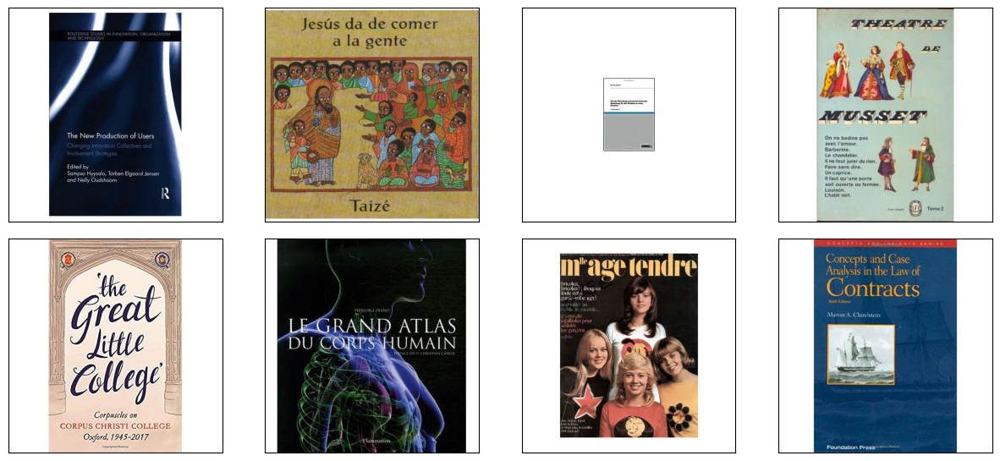

image_1232779988_product_1665914215.jpg
image_835699351_product_49182521.jpg
image_1022030320_product_515974765.jpg
image_969830009_product_210032576.jpg
image_1306918629_product_4169928272.jpg
image_1274209652_product_46703715.jpg
image_891099807_product_76203656.jpg
image_1299103555_product_103817069.jpg


In [22]:
img_sample(10, print_file_names=True)

## 40

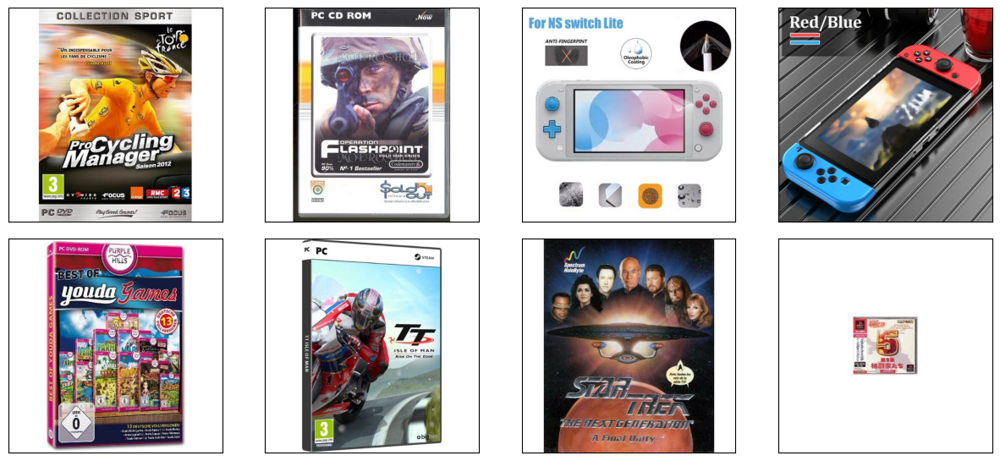

image_936565021_product_189842662.jpg
image_848934236_product_80184839.jpg
image_1313559449_product_4199252897.jpg
image_1323893710_product_4234091541.jpg
image_956536671_product_222485537.jpg
image_1170382092_product_2151614783.jpg
image_1803930_product_1283264.jpg
image_746769130_product_60594358.jpg


In [23]:
img_sample(40, print_file_names=True)

## 50

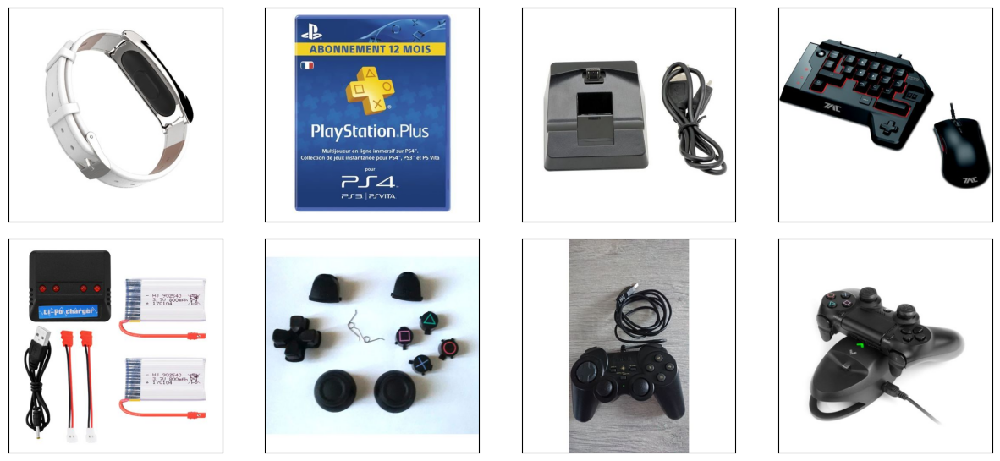

image_1317243604_product_4210986938.jpg
image_1211381278_product_3396671946.jpg
image_1096689475_product_1657857648.jpg
image_1211933981_product_1879750894.jpg
image_1107443437_product_1858695870.jpg
image_1094825074_product_1625974387.jpg
image_1240813588_product_3743470252.jpg
image_1123999612_product_2064804357.jpg


In [24]:
img_sample(50, print_file_names=True)

## 60

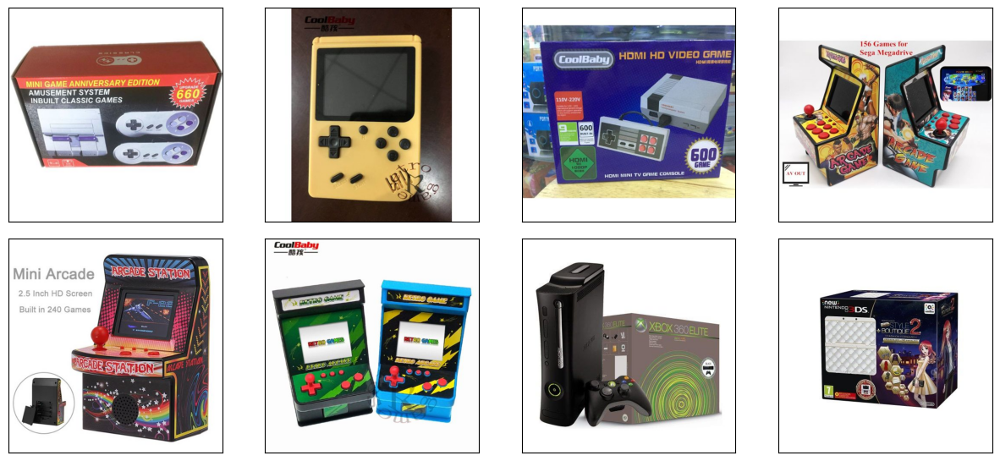

image_1316289298_product_4200882584.jpg
image_1316232448_product_4200879677.jpg
image_1316209554_product_4200877788.jpg
image_1316096363_product_4200868868.jpg
image_1316111108_product_4200870251.jpg
image_1316316967_product_4200883945.jpg
image_696939786_product_57736843.jpg
image_1100504727_product_1726905474.jpg


In [25]:
img_sample(60, print_file_names=True)

## 1140

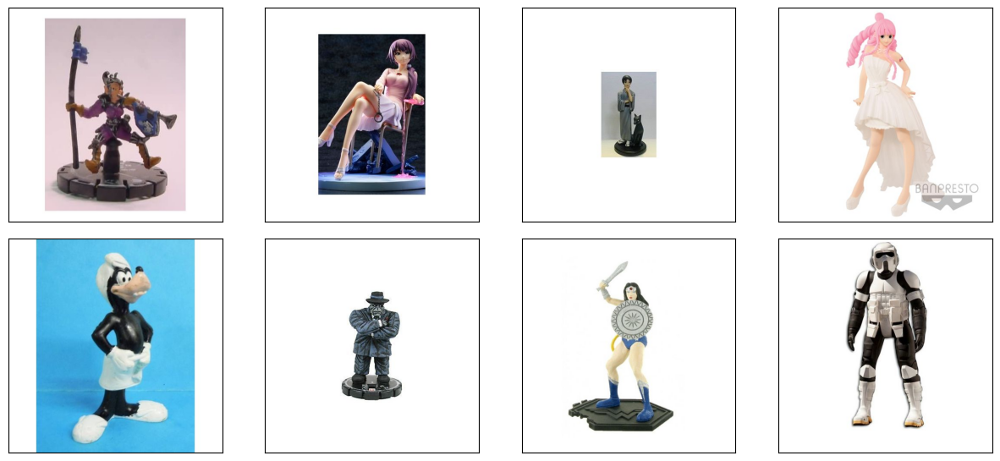

image_866682929_product_109546816.jpg
image_959984230_product_234596070.jpg
image_1124292630_product_2075082848.jpg
image_1189953765_product_3082472071.jpg
image_1011671634_product_453085631.jpg
image_548172286_product_53444776.jpg
image_1137190574_product_1960306292.jpg
image_1006708839_product_427359318.jpg


In [26]:
img_sample(1140, print_file_names=True)

## 1160

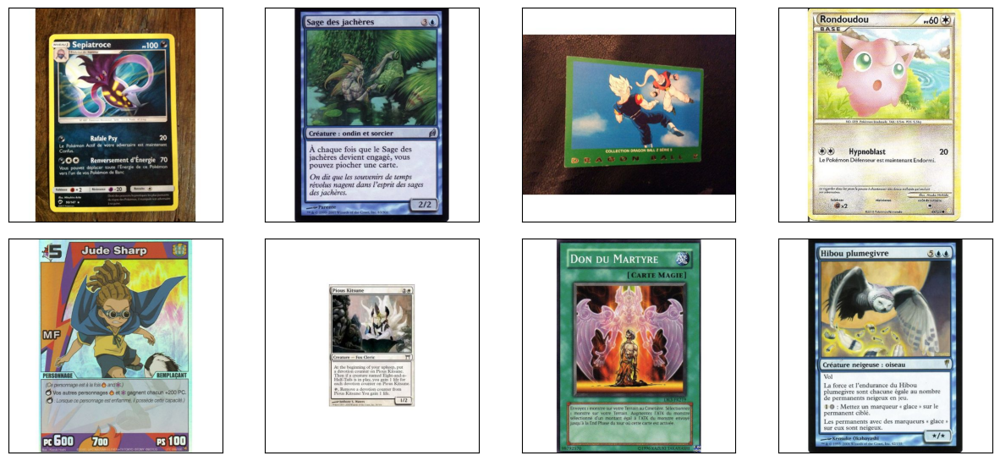

image_1138091740_product_2353251473.jpg
image_963966948_product_244966353.jpg
image_1101393024_product_122992582.jpg
image_867558845_product_110708693.jpg
image_976642642_product_276042620.jpg
image_248001999_product_7119596.jpg
image_482733163_product_50935585.jpg
image_970739717_product_258450200.jpg


In [27]:
img_sample(1160, print_file_names=True)

## 1180

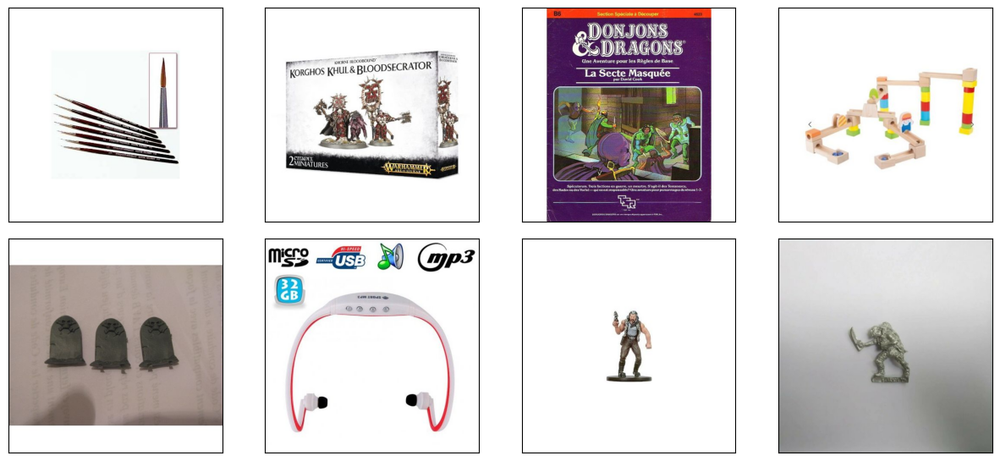

image_948476880_product_211186175.jpg
image_1126789911_product_2107748953.jpg
image_847265965_product_3197199.jpg
image_1089416971_product_1548295086.jpg
image_1039196894_product_786041105.jpg
image_1102489677_product_1800693897.jpg
image_1299069577_product_4135651018.jpg
image_1277058073_product_4011938758.jpg


In [28]:
img_sample(1180, print_file_names=True)

## 1280

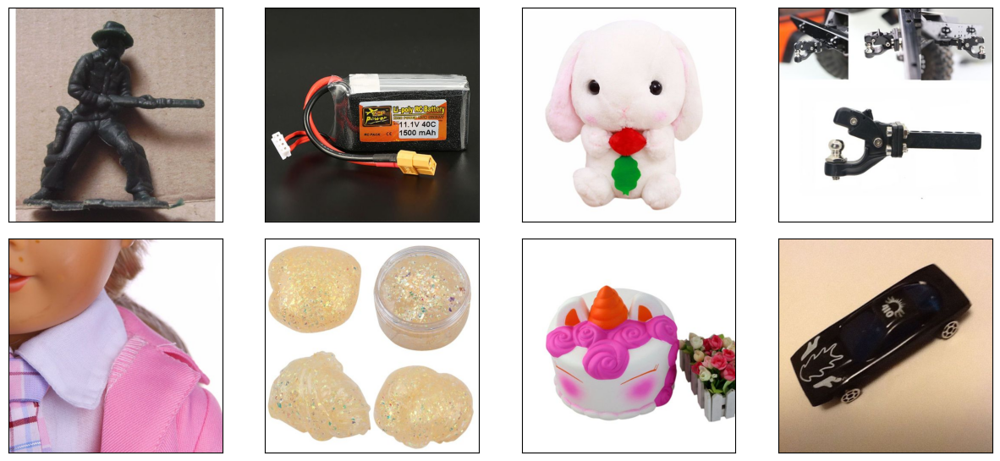

image_1188539287_product_3060265340.jpg
image_1328578347_product_4250646061.jpg
image_1275996367_product_4010298753.jpg
image_1254407086_product_3859877876.jpg
image_1282015512_product_4053879512.jpg
image_1282026855_product_4053881277.jpg
image_1255055884_product_3867033996.jpg
image_1111251337_product_1905945334.jpg


In [29]:
img_sample(1280, print_file_names=True)

## 1281

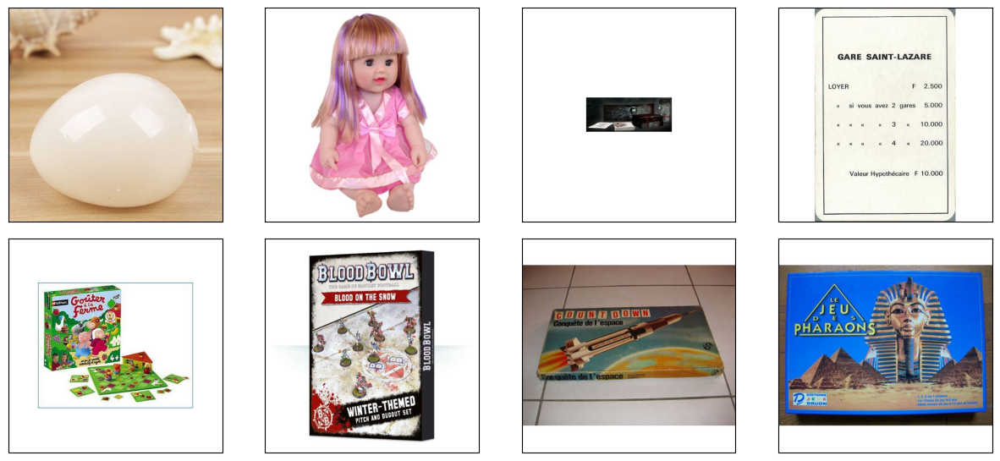

image_1275473069_product_4006487868.jpg
image_1275691383_product_4006535256.jpg
image_1264812789_product_3915933182.jpg
image_1064720273_product_1132424565.jpg
image_144675230_product_4420809.jpg
image_1151308661_product_2572488014.jpg
image_1313090897_product_4195888831.jpg
image_918518445_product_48214830.jpg


In [30]:
img_sample(1281, print_file_names=True)

## 1300

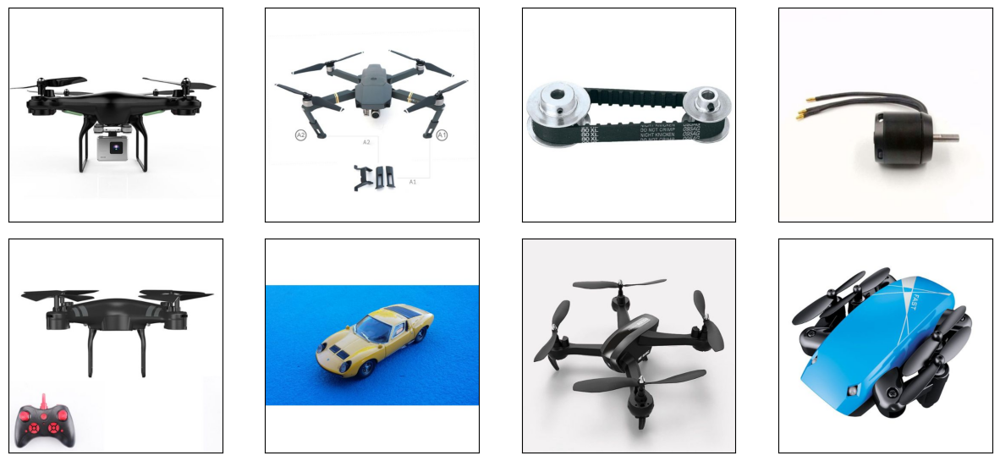

image_1313374447_product_4197668991.jpg
image_1221454703_product_3563522161.jpg
image_1005834241_product_418194972.jpg
image_1292014612_product_4105723196.jpg
image_1310033743_product_4181950247.jpg
image_1086107595_product_1507609272.jpg
image_1240727563_product_3748206566.jpg
image_1301518344_product_4150995351.jpg


In [31]:
img_sample(1300, print_file_names=True)

## 1301

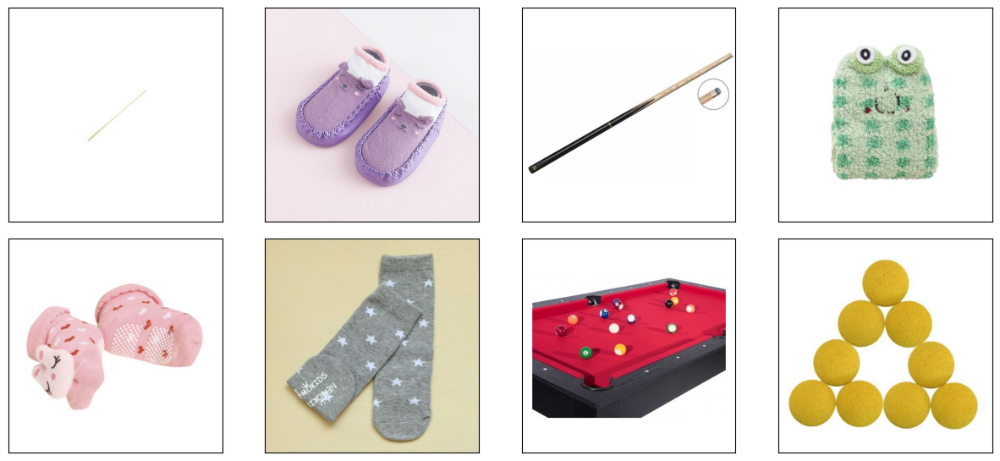

image_893310869_product_141191705.jpg
image_1261425871_product_3898728581.jpg
image_927606581_product_180669545.jpg
image_1261415462_product_3898724109.jpg
image_1261381851_product_3898717335.jpg
image_1261368557_product_3898715920.jpg
image_1318413026_product_4218867601.jpg
image_890156155_product_136255802.jpg


In [32]:
img_sample(1301, print_file_names=True)

## 1302

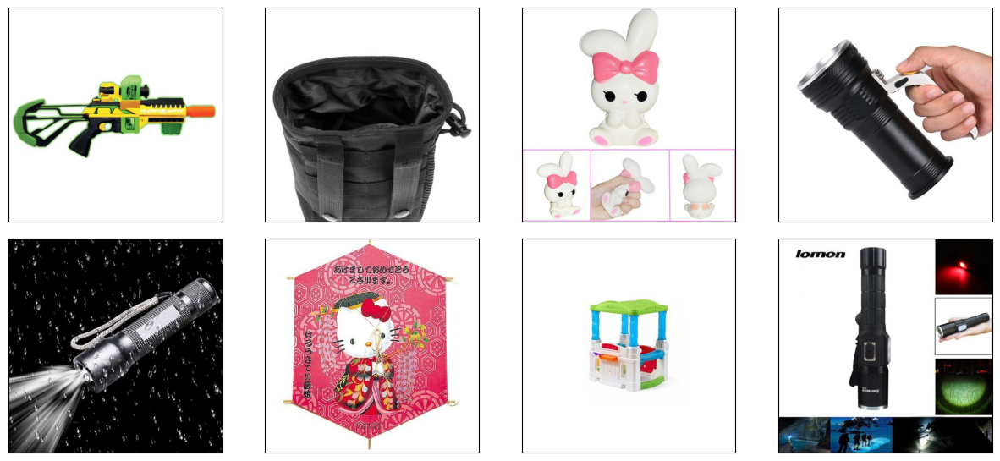

image_1318262508_product_3258697433.jpg
image_1323253433_product_4231686631.jpg
image_1276049553_product_4010225198.jpg
image_1324072323_product_4236041763.jpg
image_1324149347_product_4236042852.jpg
image_987479633_product_294335319.jpg
image_1250623951_product_3743371593.jpg
image_1324064870_product_4236041645.jpg


In [33]:
img_sample(1302, print_file_names=True)

## 1320

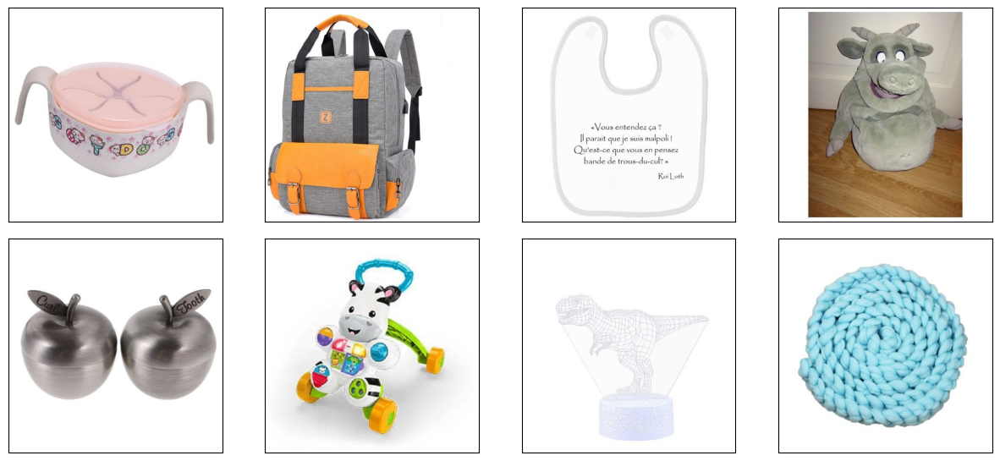

image_1306164931_product_4150350359.jpg
image_1283516437_product_4061479457.jpg
image_1192167191_product_3122749488.jpg
image_519459931_product_52654390.jpg
image_1308313656_product_4151790153.jpg
image_1320751686_product_4221598632.jpg
image_1250999481_product_3837274721.jpg
image_1134400253_product_2282877959.jpg


In [34]:
img_sample(1320, print_file_names=True)

## 1560

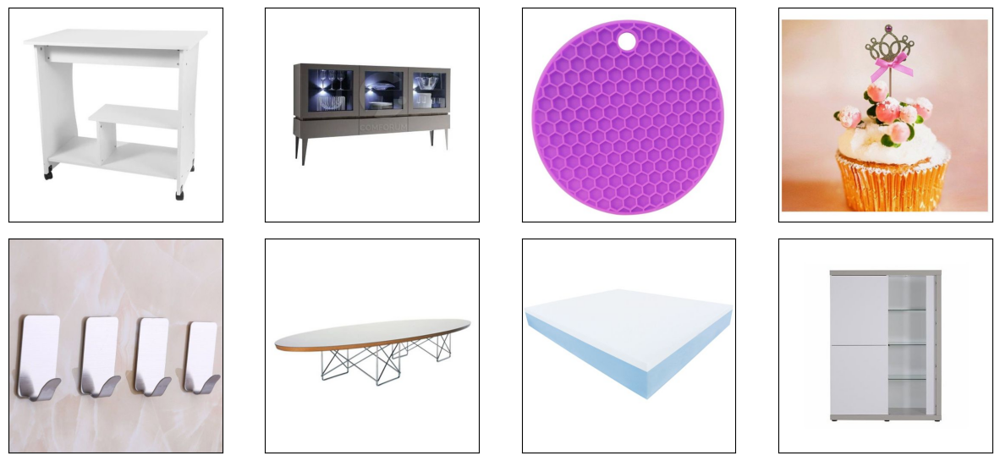

image_1270370016_product_3971614311.jpg
image_1278219982_product_4030647005.jpg
image_1310545960_product_4182254572.jpg
image_1273913107_product_3995599134.jpg
image_1269494364_product_3959361458.jpg
image_1105044540_product_1846472886.jpg
image_1130380476_product_2183600274.jpg
image_1215664649_product_3471590057.jpg


In [35]:
img_sample(1560, print_file_names=True)

## 1920

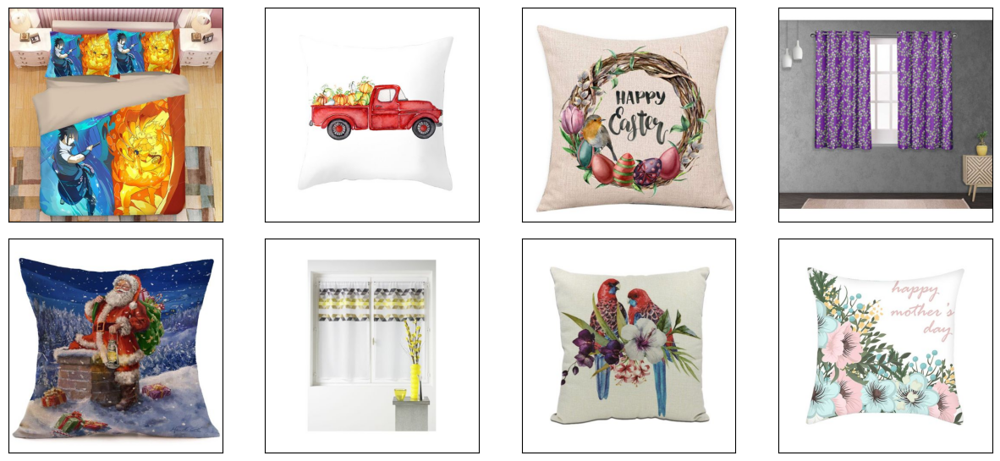

image_1271231678_product_3976409992.jpg
image_1297884947_product_4137579912.jpg
image_1323408597_product_4231838650.jpg
image_1262893116_product_3910524568.jpg
image_1323008032_product_4231799778.jpg
image_1191464868_product_3108231334.jpg
image_1273094176_product_3992398832.jpg
image_1275152913_product_4004089062.jpg


In [36]:
img_sample(1920, print_file_names=True)

## 1940

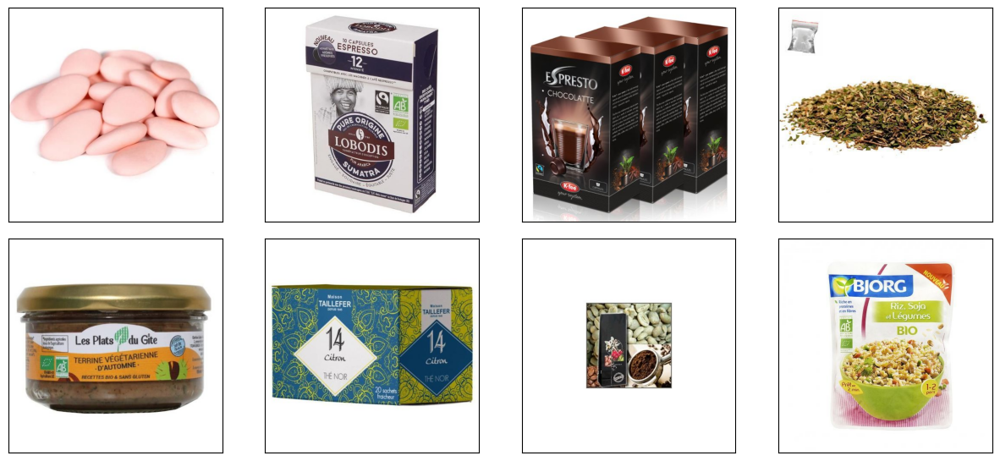

image_1276525822_product_4014008170.jpg
image_1167679336_product_2843164767.jpg
image_1282289956_product_4056000750.jpg
image_1053145010_product_988349012.jpg
image_1215990063_product_3476191751.jpg
image_1121360098_product_2034804874.jpg
image_1225888234_product_3593774995.jpg
image_1067084305_product_1175497479.jpg


In [37]:
img_sample(1940, print_file_names=True)

## 2060

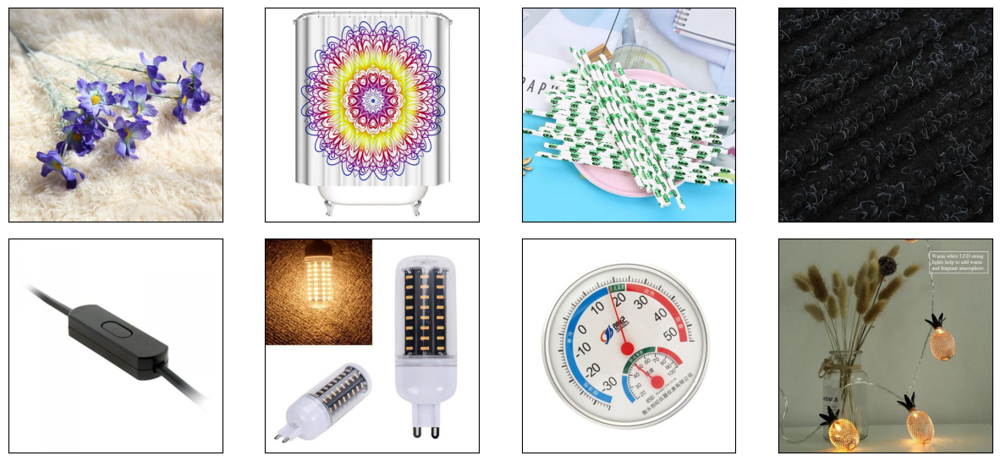

image_1240610258_product_3748052860.jpg
image_1280212123_product_4044139644.jpg
image_1262576581_product_3908953276.jpg
image_1265572718_product_3931853451.jpg
image_1248171225_product_3814507487.jpg
image_1247715355_product_3812897696.jpg
image_1313975480_product_4186106483.jpg
image_1312561096_product_4195459418.jpg


In [38]:
img_sample(2060, print_file_names=True)

## 2220

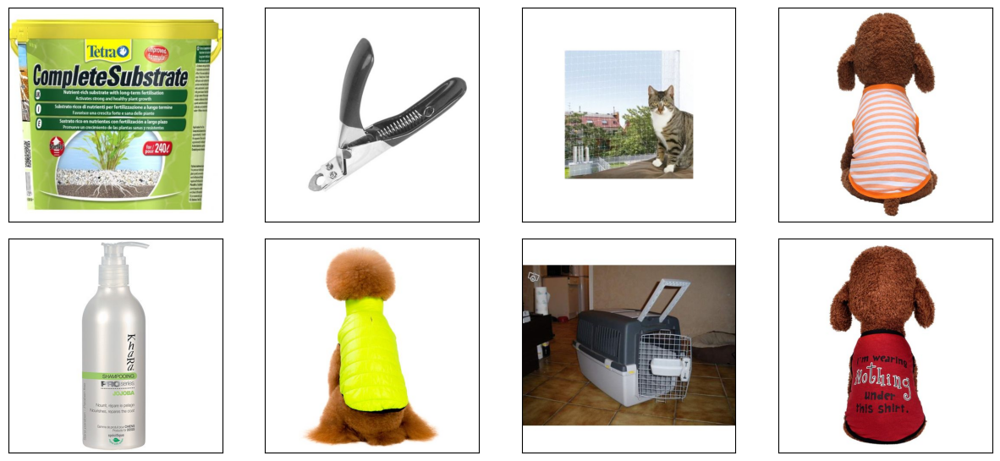

image_1106360456_product_1864410054.jpg
image_1084068225_product_1492585480.jpg
image_1020579935_product_524654378.jpg
image_1311478577_product_4187456449.jpg
image_1152181638_product_2601262388.jpg
image_1311201548_product_4182063619.jpg
image_877070621_product_122473187.jpg
image_1298036170_product_4137782638.jpg


In [39]:
img_sample(2220, print_file_names=True)

## 2280

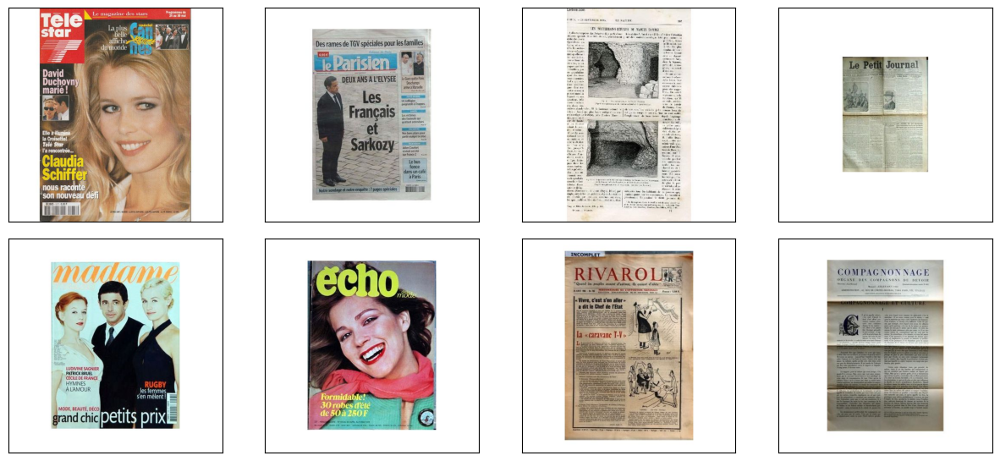

image_1110715183_product_1899240914.jpg
image_1027014597_product_569867355.jpg
image_901534709_product_7018370.jpg
image_1008168352_product_436094610.jpg
image_1026954518_product_570004069.jpg
image_1026952471_product_570003628.jpg
image_1007744179_product_435078831.jpg
image_1008036851_product_435903900.jpg


In [40]:
img_sample(2280, print_file_names=True)

## 2403

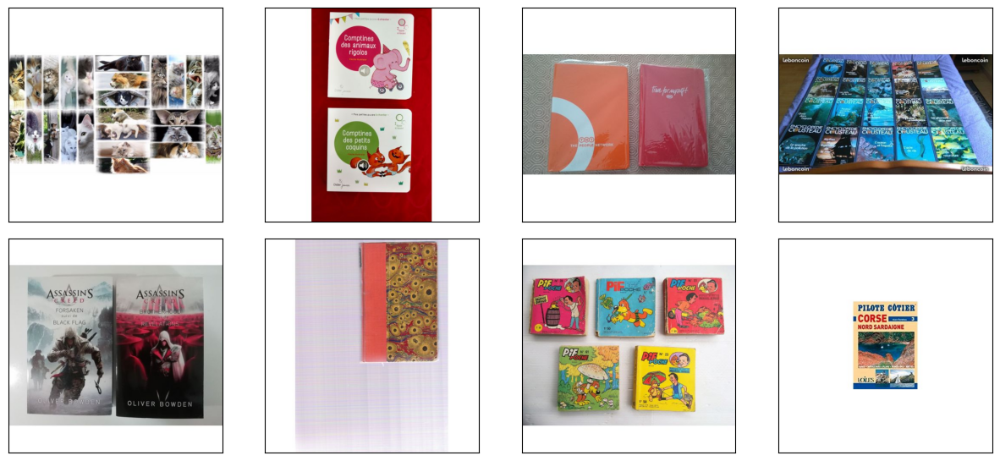

image_1089053867_product_1547138559.jpg
image_1218786911_product_3518161999.jpg
image_1048147555_product_937806248.jpg
image_1262934938_product_3912815185.jpg
image_1209572938_product_3379833287.jpg
image_882987680_product_127735333.jpg
image_1240356905_product_3746905493.jpg
image_1295336434_product_4126286853.jpg


In [41]:
img_sample(2403, print_file_names=True)

## 2462

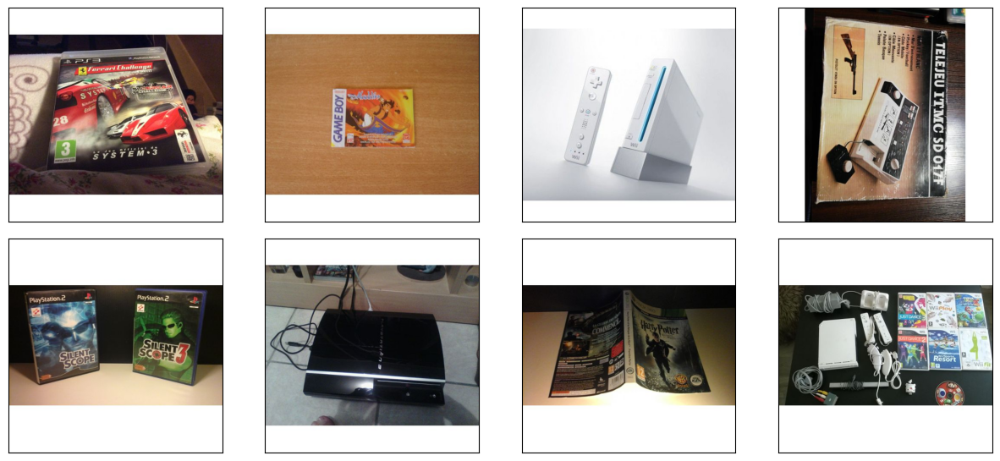

image_1158308600_product_2697715209.jpg
image_1242905562_product_3766440451.jpg
image_870156259_product_114389379.jpg
image_1247176688_product_3806467296.jpg
image_1169902729_product_2884892708.jpg
image_977410478_product_278154496.jpg
image_1206461568_product_3321837888.jpg
image_1033954996_product_671230977.jpg


In [42]:
img_sample(2462, print_file_names=True)

## 2522

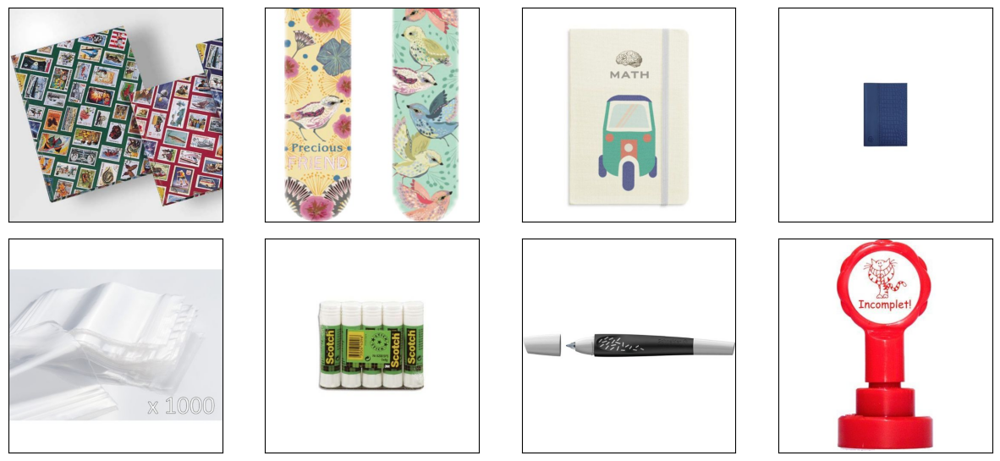

image_1248835645_product_3817894205.jpg
image_1243237959_product_3770106443.jpg
image_1305106740_product_4164667019.jpg
image_1204636731_product_3294454770.jpg
image_1240958111_product_3751598100.jpg
image_894752658_product_142135144.jpg
image_1263737551_product_3921232527.jpg
image_1174366092_product_292160789.jpg


In [43]:
img_sample(2522, print_file_names=True)

## 2582

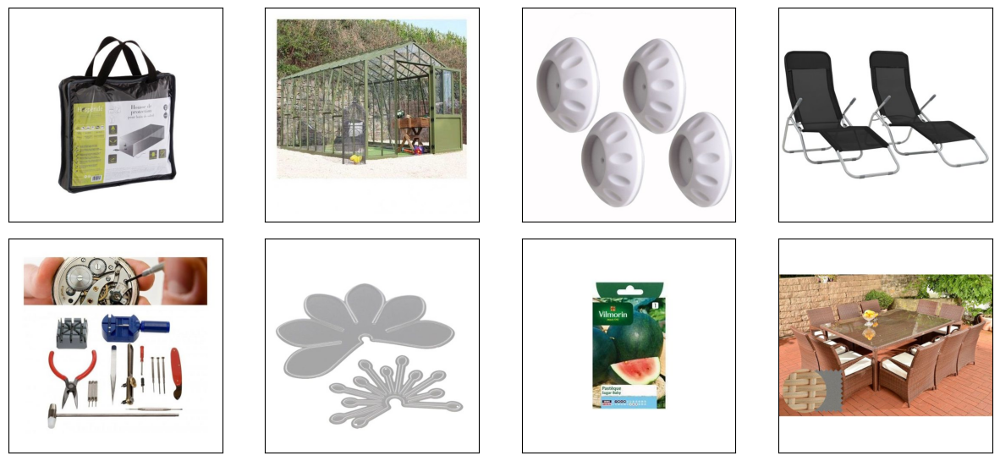

image_1190245856_product_1963991815.jpg
image_1245885895_product_3795258967.jpg
image_1246106815_product_3797081477.jpg
image_1248645671_product_3816940896.jpg
image_1168639015_product_2862279043.jpg
image_1283663373_product_4061597079.jpg
image_1117923922_product_1977820071.jpg
image_1178433310_product_2761285620.jpg


In [44]:
img_sample(2582, print_file_names=True)

## 2583

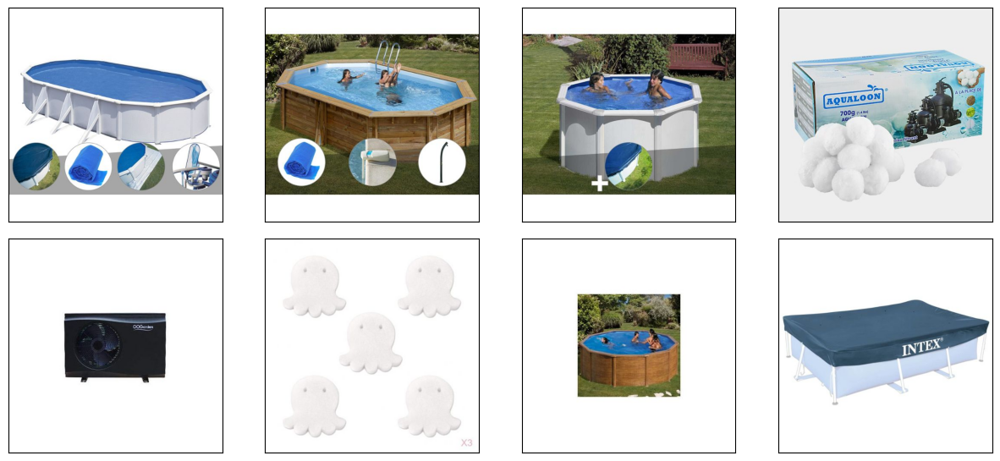

image_1244540403_product_3785187417.jpg
image_1252627634_product_3850328492.jpg
image_1243659053_product_3775275160.jpg
image_1174584487_product_2940638368.jpg
image_1225887394_product_3202218901.jpg
image_1319946787_product_4215265784.jpg
image_1188538780_product_3067204173.jpg
image_1253519665_product_3857173167.jpg


In [45]:
img_sample(2583, print_file_names=True)

## 2585

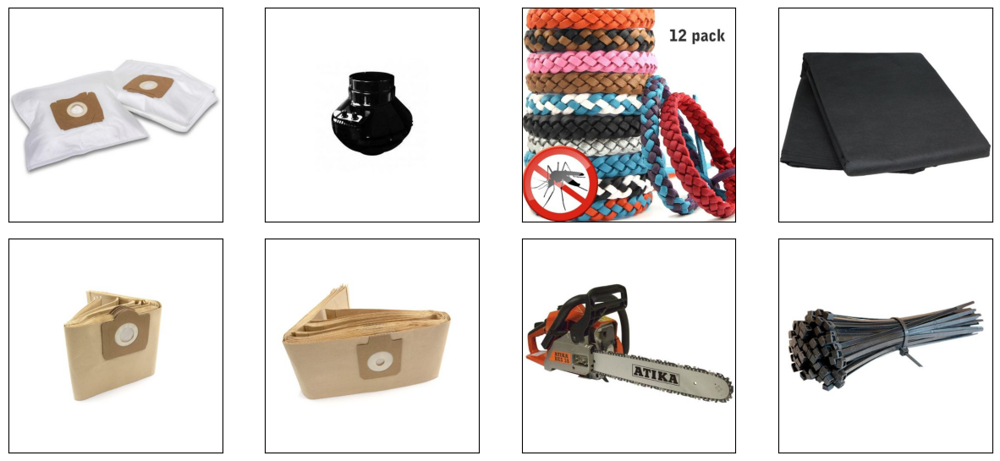

image_1188522168_product_3067034517.jpg
image_1142708403_product_2455221002.jpg
image_1314582592_product_4202305358.jpg
image_1252444631_product_3849147970.jpg
image_1156654297_product_2675087221.jpg
image_1156653241_product_2675086939.jpg
image_1231174816_product_1892600654.jpg
image_1309138897_product_4179726386.jpg


In [46]:
img_sample(2585, print_file_names=True)

## 2705

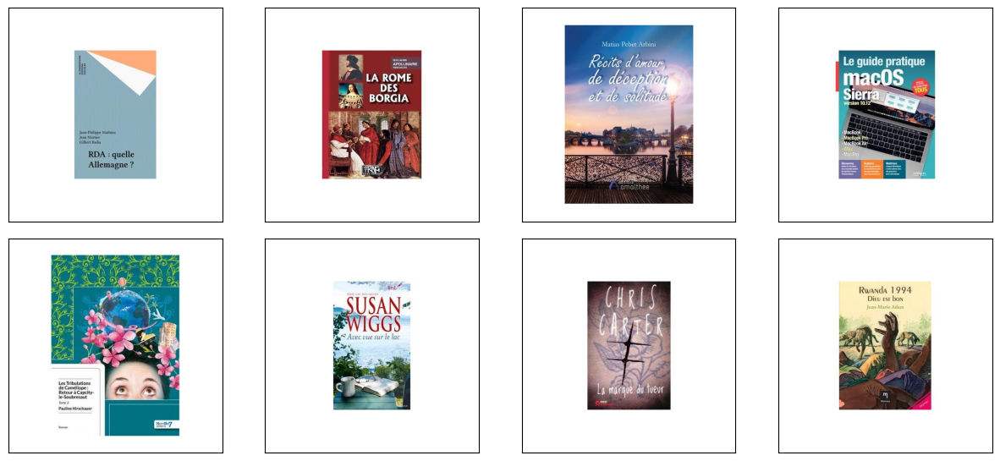

image_1198728097_product_1099447712.jpg
image_1118681368_product_1987759051.jpg
image_1268540399_product_3381283664.jpg
image_1113835676_product_1925949333.jpg
image_1285548203_product_3212881067.jpg
image_1123815209_product_2062701883.jpg
image_1213080192_product_278496057.jpg
image_1198455330_product_548524434.jpg


In [47]:
img_sample(2705, print_file_names=True)

## 2905

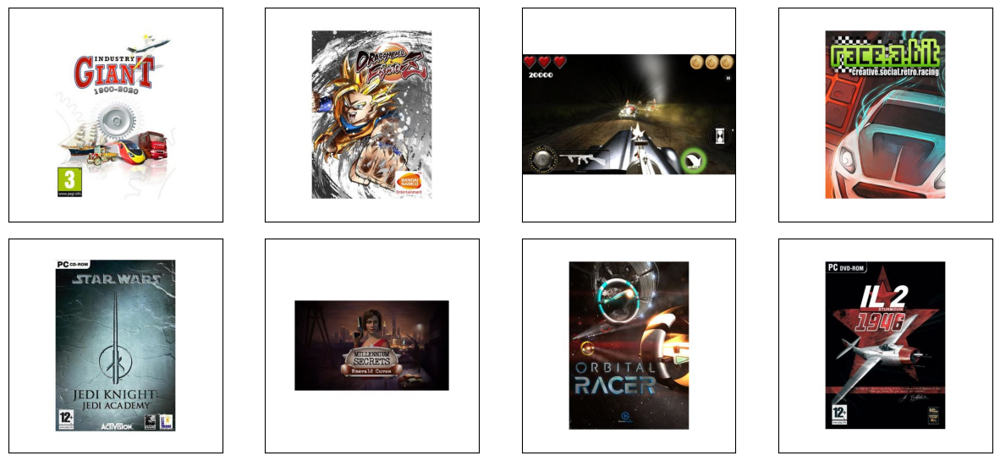

image_1100064741_product_1711736331.jpg
image_1146981189_product_2527236618.jpg
image_1100064111_product_1711734610.jpg
image_1100061225_product_1711736479.jpg
image_1100077219_product_1711735441.jpg
image_1100061052_product_1711730581.jpg
image_1197573922_product_3208369514.jpg
image_1100073738_product_1711736015.jpg


In [48]:
img_sample(2905, print_file_names=True)